In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np

import pandas as pd
import xarray as xr

import matplotlib.pyplot as plt
from cartopy import crs as ccrs
import matplotlib.pyplot as plt
import matplotlib as mpl
from yllib.plot import plot_map

%config InlineBackend.figure_format='retina'

from pypalettes import load_cmap
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates


In [2]:
root_dir = '/global/cfs/projectdirs/m1657/liuy351/TallTower/ContrastiveTransformer'
data_dir = '/global/cfs/projectdirs/m1657/liuy351/TallTower/ERA5_reduced'

In [3]:
data_option = 'allmean'
model_option = '4patch'
# cluster_option = 'ANN.r30d24h.e20' # r30d - remove 30 day running mean, 24h - 24 hour running mean
cluster_option = 'ANN.r30d24h' # r30d - remove 30 day running mean, 24h - 24 hour running mean
# cluster_option = 'ANN.r30d24h' # r30d - remove 30 day running mean, 24h - 24 hour running mean
feature_path = f'../runs/transformer_embedding.s.e10b128.2001-2024.{data_option}.{model_option}.pt'
time_idx_path = f'../data/processed/preprocessed_data_time.2001-2024.{data_option}.csv'
linkage_path = f'../runs/linkage_metrix.s.e10b128.2014-2024.{data_option}.{model_option}.{cluster_option}.npy'
clustering_label_path = f'../runs/clustering_linkage.s.e10b128.2014-2024.{data_option}.{model_option}.{cluster_option}.nc'


# feature_path = f'../runs/transformer_embedding.s.e10b128.2001-2024.{data_option}.pt'
# time_idx_path = f'../data/processed/preprocessed_data_time.2001-2024.{data_option}.csv'
# linkage_path = f'../runs/linkage_metrix.s.e10b128.2014-2024.{data_option}.{cluster_option}.npy'
# clustering_label_path = f'../runs/clustering_linkage.s.e10b128.2014-2024.{data_option}.{cluster_option}.nc'

In [4]:
cluster_labels = xr.open_dataset(clustering_label_path)['cluster']
cluster_labels

<xarray.DataArray 'cluster' (time: 89824, threshold: 11)> Size: 4MB
[988064 values with dtype=int32]
Coordinates:
  * time       (time) datetime64[ns] 719kB 2014-01-01 ... 2024-03-31T15:00:00
  * threshold  (threshold) int64 88B 2500 5000 5500 6000 ... 9000 12000 13000

In [5]:
# from IPython.display import display
# pd.options.display.max_columns = None
# pd.options.display.max_rows = None
cluster_labels.to_pandas().to_csv('test.csv')
cluster_labels.sel(time=slice('2023-08-01 00:00', '2023-08-31 00:00')).to_pandas()[5000]

time
2023-08-01 00:00:00    10
2023-08-01 01:00:00    10
2023-08-01 02:00:00    10
2023-08-01 03:00:00    10
2023-08-01 04:00:00    10
                       ..
2023-08-30 20:00:00    19
2023-08-30 21:00:00    19
2023-08-30 22:00:00    19
2023-08-30 23:00:00    19
2023-08-31 00:00:00    19
Name: 5000, Length: 721, dtype: int32

## Composite analysis

In [6]:
for threshold in cluster_labels.coords['threshold']:
    print(f'Threshold: {threshold.data}, in total {np.unique(cluster_labels.sel(threshold=threshold)).size} clusters')


Threshold: 2500, in total 153 clusters
Threshold: 5000, in total 33 clusters
Threshold: 5500, in total 28 clusters
Threshold: 6000, in total 21 clusters
Threshold: 6500, in total 18 clusters
Threshold: 7000, in total 15 clusters
Threshold: 7200, in total 14 clusters
Threshold: 8000, in total 10 clusters
Threshold: 9000, in total 8 clusters
Threshold: 12000, in total 4 clusters
Threshold: 13000, in total 3 clusters


## High level clusters and their low level subclusters:
| High lelvel| 18 levels| 12 levels |
|------------| -------- | --------- |
| High level cluster 7 contains low level clusters| [14]  | [14]| 
| High level cluster 4 contains low level clusters| [9]   | [9]| 
| High level cluster 5 contains low level clusters| [10, 11]√| [10]| 
| High level cluster 6 contains low level clusters| [12, 13] √| [12]| 
| High level cluster 2 contains low level clusters| [3, 4]| [3, 4]| 
| High level cluster 8 contains low level clusters| [16, 17, 18, 15]| [15,16,17,18]|
| High level cluster 3 contains low level clusters| [8, 5, 6, 7] √| [5] | 
| High level cluster 1 contains low level clusters| [1, 2] √| [1] |


## High level clusters and their low level subclusters:
| High lelvel| 18 levels| 12 levels |
|------------| -------- | --------- |
| High level cluster 4 contains low level clusters| [14, 15, 16, 17, 18]   | [14,15,16,17,18]| 
| High level cluster 3 contains low level clusters| [9, 10, 11, 12, 13] | [9,10,12] | 
| High level cluster 2 contains low level clusters| [3, 4, 5, 6, 7, 8]]| [3, 4, 5]| 
| High level cluster 1 contains low level clusters| [1, 2] √| [1] |

In [7]:
threshold4 = 12000
threshold6 = 6500

# threshold4 = 10000
# threshold6 = 8000

labels4 = cluster_labels.sel(threshold=threshold4)
unique_labels4 = np.unique(labels4)
ncluster4 = unique_labels4.size
print(f'Threshold selected: {threshold4}, in total {ncluster4} clusters')

labels6 = cluster_labels.sel(threshold=threshold6)
unique_labels6 = np.unique(labels6)
ncluster6 = unique_labels6.size
print(f'Threshold selected: {threshold6}, in total {ncluster6} clusters')

Threshold selected: 12000, in total 4 clusters
Threshold selected: 6500, in total 18 clusters


In [125]:
labels_high = labels4.sel(time=slice('2023-08-01 00:00', '2023-11-30 23:00'))
labels_low  = labels6.sel(time=slice('2023-08-01 00:00', '2023-11-30 23:00'))


In [126]:
def find_segments(series):
    segments = []
    current_type = series[0]
    current_start = series.index[0]
    for i in range(1, len(series)):
        if series[i] != current_type:
            current_end = series.index[i-1]
            duration = (current_end - current_start).total_seconds() / 3600  # 计算持续时间（小时）
            segments.append((current_type, current_start, current_end, duration))
            current_type = series[i]
            current_start = series.index[i]
    current_end = series.index[-1]
    duration = (current_end - current_start).total_seconds() / 3600
    segments.append((current_type, current_start, current_end, duration))
    return segments

# 
def merge_segments(segments, min_duration=12):
    merged_segments = []
    i = 0
    while i < len(segments):
        weather_type, start, end, duration = segments[i]
        if duration < min_duration:
            if i > 0:
                prev_type, prev_start, prev_end, prev_duration = merged_segments[-1]
                merged_segments[-1] = (prev_type, prev_start, end, prev_duration + duration)
            elif i < len(segments) - 1:
                next_type, next_start, next_end, next_duration = segments[i + 1]
                merged_segments.append((next_type, start, next_end, duration + next_duration))
                i += 1
            else:
                merged_segments.append((weather_type, start, end, duration))
        else:
            merged_segments.append((weather_type, start, end, duration))
        i += 1
    return merged_segments

segments = find_segments(labels_low.to_pandas())
merged_segments = merge_segments(segments, min_duration=12)
merged_segments_df = pd.DataFrame(merged_segments, columns=['WeatherType', 'Start', 'End', 'Duration'])

labels_adjusted = []
for weather_type, start, end, _ in merged_segments:
    hours = (end-start).total_seconds()/3600.
    labels_adjusted.extend([weather_type] * int(hours + 1))
labels_adjusted = xr.DataArray(labels_adjusted, dims=labels_low.dims, coords=labels_low.coords, name='cluster')
# xr.concat([labels, labels_adjusted], dim='labs').to_pandas().T

/tmp/ipykernel_88659/1859859710.py:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  current_type = series[0]
/tmp/ipykernel_88659/1859859710.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if series[i] != current_type:
/tmp/ipykernel_88659/1859859710.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  current_type = series[i]



## High level clusters and their low level subclusters:
| High lelvel| 18 levels| 12 levels |
|------------| -------- | --------- |
| High level cluster 6 contains low level clusters| [18]   | [18]| 
| High level cluster 5 contains low level clusters| [17] | [17] | 
| High level cluster 4 contains low level clusters| [14, 15, 16]   | [14,15,16]| 
| High level cluster 3 contains low level clusters| [9, 10, 11, 12, 13] | [9,10,12] | 
| High level cluster 2 contains low level clusters| [3, 4, 5, 6, 7, 8]]| [3, 4, 5]| 
| High level cluster 1 contains low level clusters| [1, 2] √| [1] |

In [127]:
# merge labels
def merge_labels(labels, source, target):
    for s in source:
        labels = xr.where(labels==s, target, labels)
    return labels

labels_merged1 = merge_labels(labels_adjusted, [5,6,7,8], 1005)
labels_merged1 = merge_labels(labels_merged1, [10,11], 1010)
labels_merged1 = merge_labels(labels_merged1, [12,13], 1012)
labels_merged1 = merge_labels(labels_merged1, [3,4], 1003) # few 3
labels_merged1 = merge_labels(labels_merged1, [1,2], 1001) # 1 is not in lidar period
for i in [9, 14, 15, 16, 17, 18]:
    labels_merged1 = merge_labels(labels_merged1, [i], 1000+i) 
labels_merged1 = labels_merged1 - 1000

# labels_merged4 = merge_labels(labels_merged, [14,15,16,17,18], 1004)
labels_merged2 = merge_labels(labels_merged1, [18], 1006)
labels_merged2 = merge_labels(labels_merged2, [17], 1005)
labels_merged2 = merge_labels(labels_merged2, [14,15,16], 1004)
labels_merged2 = merge_labels(labels_merged2, [9,10,12], 1003)
labels_merged2 = merge_labels(labels_merged2, [3,4,5], 1002)
labels_merged2 = merge_labels(labels_merged2, [1,2], 1001)
labels_merged2 = labels_merged2 - 1000


In [128]:
np.unique(labels_adjusted).size, np.unique(labels_merged1).size, np.unique(labels_merged2).size

(15, 10, 5)

In [129]:
labels = labels_adjusted

### **Read met and lidar data**

In [130]:
def read_met_data(var, vname, time):
    # fname = f'{datadir}/{var}.2001-2024.anomaly.nc'
    fname = f'{data_dir}/{var}.2001-2024.nc'
    with xr.open_dataset(fname) as ds:
        da = ds[vname].squeeze()
        time = np.intersect1d(da.time, time)
        da = da.sel(time=time)
    return da

sp = read_met_data('sp', 'SP', labels.time) / 100.
t2 = read_met_data('2t', 'VAR_2T', labels.time) -273.15
z500 = read_met_data('z500', 'Z', labels.time) / 100.
z850 = read_met_data('z850', 'Z', labels.time) / 100
t500 = read_met_data('t500', 'T', labels.time)
t850 = read_met_data('t850', 'T', labels.time)
u100 = read_met_data('100u', 'VAR_100U', labels.time)
v100 = read_met_data('100v', 'VAR_100V', labels.time)

sp.shape

(2928, 37, 45)

In [131]:
wind_lidar = []
for m in [8,9,10,11]:
    wind_lidar.append(xr.open_dataset(f'../../DATA/sonia_lidar/lidar_2023_{m:02d}.nc'))
wind_lidar = xr.concat(wind_lidar, dim='time')
wind_lidar = wind_lidar.where(wind_lidar<1000.)
wind_lidar = wind_lidar.resample(time='30T').mean() 
wind_lidar

/global/homes/y/yeliu/.conda/envs/compute/lib/python3.11/site-packages/xarray/core/groupby.py:668: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  index_grouper = pd.Grouper(


<xarray.Dataset> Size: 2MB
Dimensions:  (level: 11, time: 5856)
Coordinates:
  * level    (level) float64 88B 84.0 94.0 104.0 112.0 ... 184.0 204.0 224.0
  * time     (time) datetime64[ns] 47kB 2023-08-01 ... 2023-11-30T23:30:00
Data variables:
    uv       (time, level) float64 515kB 3.816 4.295 4.568 ... 4.226 4.379 4.533
    wdir     (time, level) float64 515kB 269.5 267.6 267.3 ... 171.6 170.8 169.8
    w        (time, level) float64 515kB -0.1361 -0.08586 ... -1.223 -1.198

### **Plot lidar timeseries vs WPs**

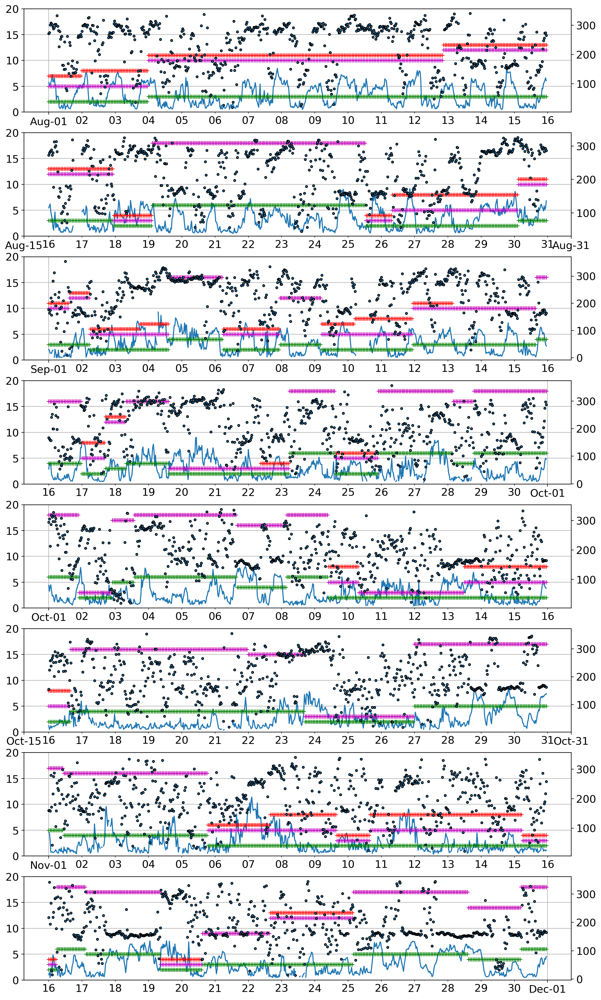

In [132]:
fig, axs = plt.subplots(8, 1, figsize=(14, 25))
axs = axs.ravel()

seltimes = [
    ('2023-08-01 00:00', '2023-08-15 23:00:00'),
    ('2023-08-16 00:00', '2023-08-30 23:00:00'),
    ('2023-09-01 00:00', '2023-09-15 23:00:00'),
    ('2023-09-16 00:00', '2023-09-30 23:00:00'),
    ('2023-10-01 00:00', '2023-10-15 23:00:00'),
    ('2023-10-16 00:00', '2023-10-30 23:00:00'),
    ('2023-11-01 00:00', '2023-11-15 23:00:00'),
    ('2023-11-16 00:00', '2023-11-30 23:00:00')
]

for ax, seltime in zip(axs, seltimes):
    disp = wind_lidar.sel(level=204).sel(time=slice(*seltime))
    ax.plot(disp.time, disp['uv'])
    ax1 = ax.twinx()
    ax1.plot(disp.time, disp['wdir'], ls='none', marker='.', mec='k')                       
    
                                         
    ax.plot(labels_adjusted.sel(time=slice(*seltime)).time, labels_adjusted.sel(time=slice(*seltime)), ls='none', marker='+', mec='r')
    ax.plot(labels_merged2.sel(time=slice(*seltime)).time, labels_merged2.sel(time=slice(*seltime)), ls='none', marker='+', mec='g')
    ax.plot(labels_merged1.sel(time=slice(*seltime)).time, labels_merged1.sel(time=slice(*seltime)), ls='none', marker='+', mec='m')

    ax.grid()
    ax.set_ylim(0,20)
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_minor_locator(mdates.DayLocator())
    ax.xaxis.set_major_formatter(DateFormatter('%b-%d'))
    ax.xaxis.set_minor_formatter(DateFormatter('%d'))

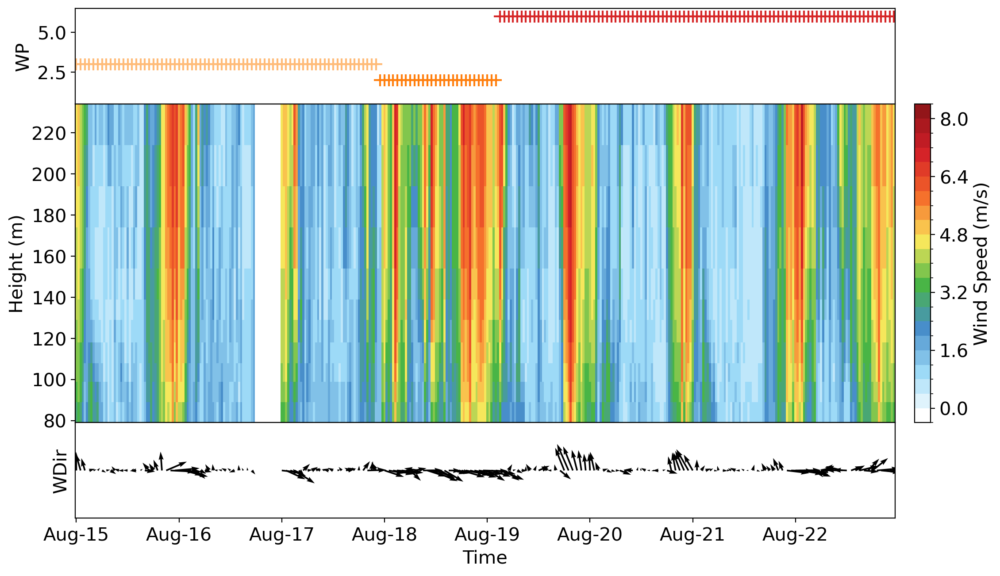

In [133]:
from func_plot_cross_section import plot_cross_section

from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates

fig, ax = plt.subplots(
    1, 1, figsize=(12, 4), 
    # dpi=300,
)
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.03, wspace=0.05)

seltime = ('2023-08-15 00:00', '2023-08-22 23:00:00')
# seltime = ('2023-11-18 00:00', '2023-11-28 23:00:00')

cross_section = wind_lidar.sel(time=slice(*seltime))
cax, clev = plot_cross_section(
    cross_section['uv'].T, 
    lat=cross_section.level, lon=cross_section.time, 
    fig=fig, ax=ax,
    clev=[-10000]+list(np.linspace(0,8,21))+[10000],
    # u=-cross_section['uv'].T * np.cos(cross_section['wdir'].T * np.pi /180.), v=cross_section['w'].T *10,
    # u=-cross_section['uv'].T * np.sin(cross_section['wdir'].T * np.pi /180.), v=-cross_section['uv'].T * np.cos(cross_section['wdir'].T * np.pi /180.),

)
ax.set_ylabel('Height (m)')
ax.set_xticks([])
plt.colorbar(cax, ax=ax, ticks=clev[1:-1:4], label='Wind Speed (m/s)', pad=0.02)


ax2 = ax.inset_axes([0, -0.3, 1, 0.3], transform=ax.transAxes)
u = -cross_section['uv'].T * np.sin(cross_section['wdir'].T * np.pi /180.)
v = -cross_section['uv'].T * np.cos(cross_section['wdir'].T * np.pi /180.)
u = u.sel(level=204)
v = v.sel(level=204)
ax2.quiver(cross_section.time[::2], np.zeros(u.size)[::2], u[::2], v[::2], scale=200, linewidth=0.1, width=0.002)
ax2.set_xlim(*ax.get_xlim())
ax2.set_xlabel('Time')
ax2.set_ylabel('WDir')
ax2.set_yticks([])

colors = {1: 'red', 2: 'blue', 3: 'green', 4: 'purple', 5:'tab:gray', 6:'tab:orange', 7:'tab:green', 8:'tab:gray', 9:'tab:purple', 10:'yellow', 11:'black'}
xlabels = labels_merged2.sel(time=slice(*seltime))
category_colors = [plt.cm.tab20(i) for i in xlabels.data]
ax3 = ax.inset_axes([0, 1, 1, 0.3], transform=ax.transAxes)
xlabels = labels_merged2.sel(time=slice(*seltime))
# ax3.plot(xlabels.time, xlabels, ls='none', marker='+', mfc='r')
ax3.scatter(xlabels.time, xlabels, c=category_colors, marker='+', s=100)

ax3.set_xlim(*ax.get_xlim())
ax3.set_xticks([])
ax3.set_ylim(0.5, 6.5)
ax3.set_ylabel('WP')

# ax2.xaxis.set_major_formatter(DateFormatter('%b-%d'))
# fig.autofmt_xdate()
# ax2.xaxis.set_major_locator(mdates.MonthLocator())
ax2.xaxis.set_minor_locator(mdates.DayLocator())
ax2.xaxis.set_major_formatter(DateFormatter('%b-%d'))
ax2.xaxis.set_minor_formatter(DateFormatter('%d'))

### **Plot $\Delta P$ vs Max wind speed**

In [134]:
west_rect = [-123.8, -122.5, 45.4, 46.4]
east_rect = [-120.8, -119.5, 45.4, 46.4]
def sel_rectangle(da, rect):
    return da.sel(longitude=slice(rect[0]+360, rect[1]+360), latitude=slice(rect[3], rect[2]))
sp_west = sel_rectangle(sp, west_rect).mean(['latitude','longitude'])
sp_east = sel_rectangle(sp, east_rect).mean(['latitude','longitude'])
dp = sp_west - sp_east

t2_west = sel_rectangle(t2, west_rect).mean(['latitude','longitude'])
t2_east = sel_rectangle(t2, east_rect).mean(['latitude','longitude'])
dt = t2_east - t2_west

In [135]:
def mode(arr, axis=None):
    values, counts = np.unique(arr, return_counts=True)
    return values[np.argmax(counts)]

def calc_daily_aggregation(da, freq='H', method='mean'):
    all_hours = pd.date_range(start=da.time.min().values, end=da.time.max().values, freq=freq)
    
    da = da.reindex(time=all_hours)
    # if fill=='ffill': da = da.ffill(time=all_hours)

    if method=='mean': return da.resample(time='D').mean()
    if method=='max': return da.resample(time='D').max()
    if method=='most_freq': return da.resample(time='D').reduce(mode)


In [136]:
dp_day_mean = calc_daily_aggregation(dp, freq='h',  method='mean')
dt_day_mean = calc_daily_aggregation(dt, freq='h',  method='mean')
lidar_day_max = calc_daily_aggregation(wind_lidar['uv'].sel(level=204), freq='30min', method='max')
labels_day_merged1  = calc_daily_aggregation(labels_merged1, freq='h', method='most_freq')
labels_day_merged2  = calc_daily_aggregation(labels_merged2, freq='h', method='most_freq')
labels_day_adjusted = calc_daily_aggregation(labels_adjusted, freq='h', method='most_freq')
labels_day_merged1.name = 'cluster_merged1'
labels_day_merged2.name = 'cluster_merged2'
labels_day_adjusted.name = 'cluster_adjusted'

labels_day_adjusted.to_pandas()[:20]

time
2023-08-01     7
2023-08-02     8
2023-08-03     8
2023-08-04    11
2023-08-05    11
2023-08-06    11
2023-08-07    11
2023-08-08    11
2023-08-09    11
2023-08-10    11
2023-08-11    11
2023-08-12    11
2023-08-13    13
2023-08-14    13
2023-08-15    13
2023-08-16    13
2023-08-17    13
2023-08-18     4
2023-08-19    18
2023-08-20    18
Freq: D, dtype: int32

In [137]:
daily_agg = xr.merge([dp_day_mean, dt_day_mean, lidar_day_max, labels_day_merged1, labels_day_merged2, labels_day_adjusted], join='inner')
# daily_agg.to_pandas()[-30:]
# daily_agg = daily_agg.dropna(dim='time')


In [138]:
new_time = pd.date_range(start='2023-08-01 00:00', end='2023-11-30 00:00', freq='30min')
labels_lidar_day_merged1  = daily_agg['cluster_merged1'].reindex(time=new_time, method='ffill')
labels_lidar_day_merged2  = daily_agg['cluster_merged2'].reindex(time=new_time, method='ffill')
labels_lidar_day_adjusted = daily_agg['cluster_adjusted'].reindex(time=new_time, method='ffill')

new_time = pd.date_range(start='2023-08-01 00:00', end='2023-11-30 00:00', freq='h')
labels_met_day_merged1  = daily_agg['cluster_merged1'].reindex(time=new_time, method='ffill')
labels_met_day_merged2  = daily_agg['cluster_merged2'].reindex(time=new_time, method='ffill')
labels_met_day_adjusted = daily_agg['cluster_adjusted'].reindex(time=new_time, method='ffill')


/global/homes/y/yeliu/.conda/envs/compute/lib/python3.11/site-packages/pypalettes/main.py:129: UserWarning: Using a continuous palette for a non-sequential palette can pose a problem in terms of the meaning of the graphs. Shut down this warning with `type_warning = False`. See https://blog.datawrapper.de/colors/ for more information.
  warnings.warn(


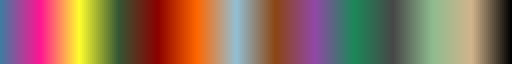

In [139]:
cmap = load_cmap('gravityFalls', type='continuous')
cmap

2 6


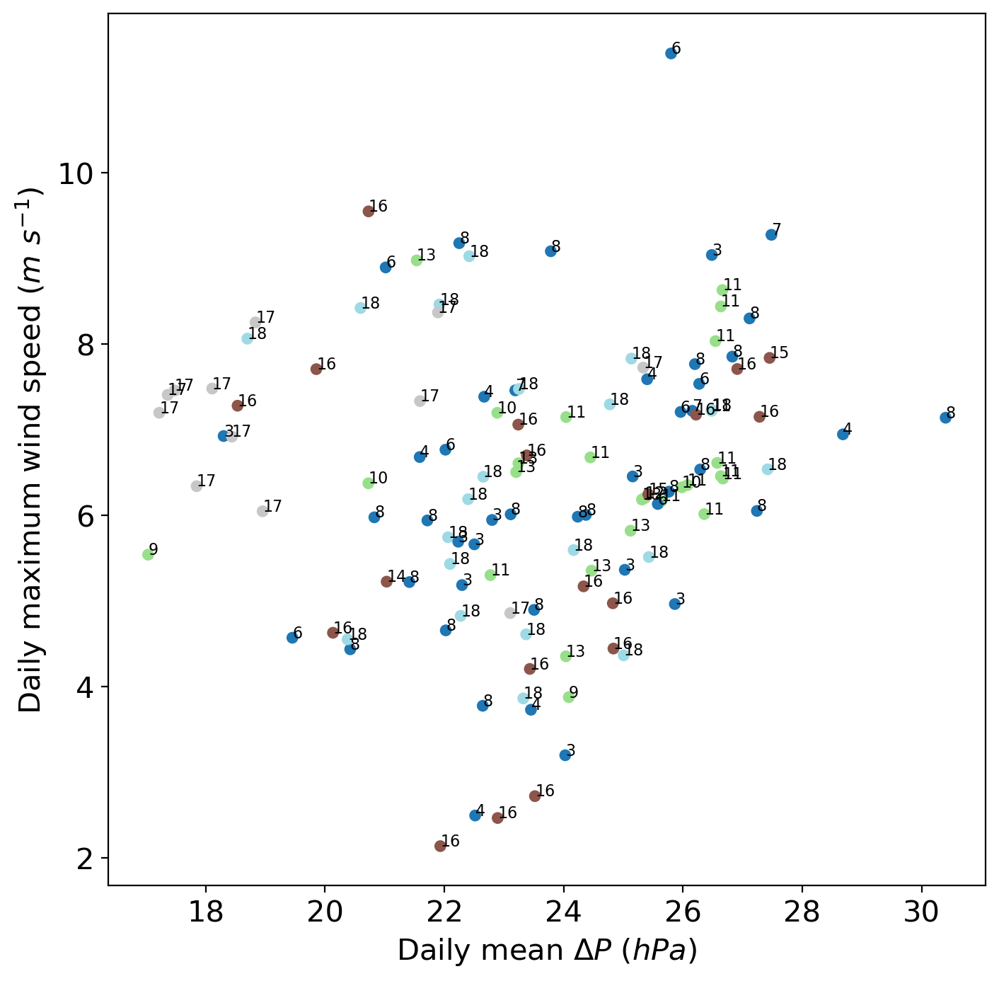

In [140]:
fig, ax = plt.subplots(1,1,figsize=(8, 8), dpi=100)

colors = {1: 'red', 2: 'blue', 3: 'green', 4: 'purple', 5:'tab:gray', 6:'tab:orange', 7:'tab:green', 8:'tab:gray', 9:'tab:purple', 10:'yellow', 11:'black'}
xlabels = daily_agg['cluster_merged2']#.sel(time=slice(*seltime))
def create_category_colors(data, cmap):
    vmin, vmax = data.min(), data.max()
    print(vmin, vmax)
    return [cmap((i-vmin)/(vmax-vmin)) for i in data]
category_colors = create_category_colors(daily_agg['cluster_merged2'].data, plt.cm.tab20)
ax.scatter(daily_agg['SP'], daily_agg['uv'], c=category_colors, marker='.', s=100)
ax.set_xlabel('Daily mean $\Delta P$ ($hPa$)')
ax.set_ylabel('Daily maximum wind speed ($m\ s^{-1}$)')
for i, (xx, yy) in enumerate(zip(daily_agg['SP'], daily_agg['uv'])):
    # ax.text(xx.data, yy.data, xx.time.dt.strftime('%m%d').data, fontsize=5)
    ax.text(xx.data, yy.data, daily_agg['cluster_adjusted'].data[i], fontsize=8)
    # if xx.time.dt.strftime('%m%d').data == '1022': ax.text(xx.data, yy.data, xx.time.dt.strftime('%m%d').data, color='red', fontsize=5)


KeyError: "No variable named 'cluster'. Variables on the dataset include ['time', 'SP', 'VAR_2T', 'level', 'uv', 'threshold', 'cluster_merged1', 'cluster_merged2', 'cluster_adjusted']"

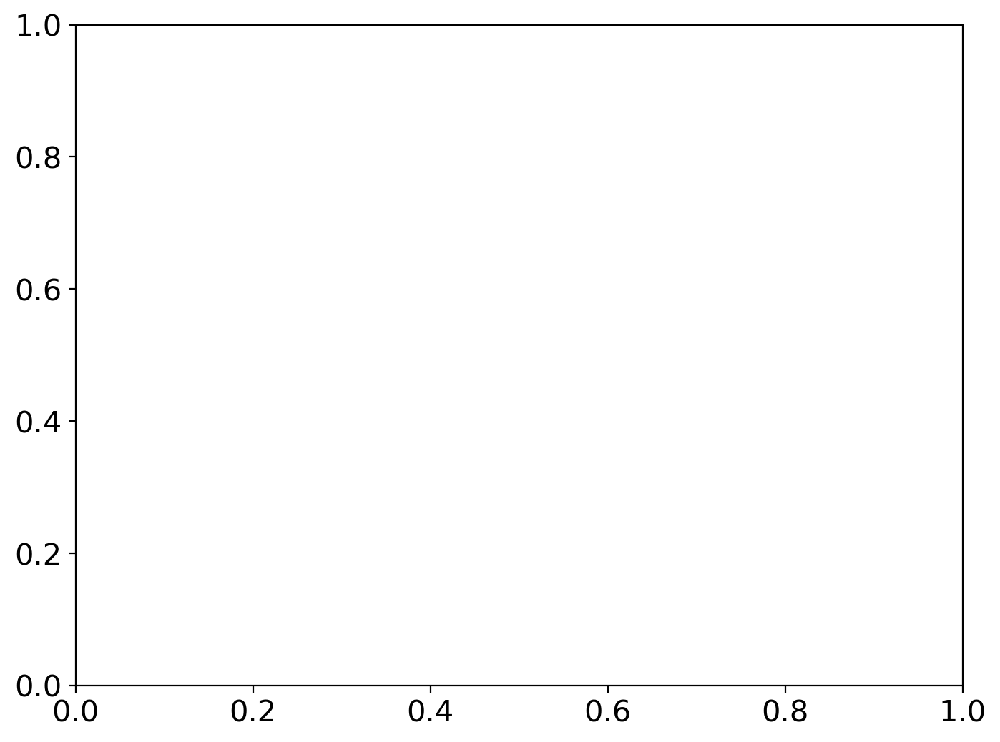

In [141]:
fig, ax = plt.subplots(1,1,figsize=(8, 6), dpi=100)

colors = {1: 'red', 2: 'blue', 3: 'green', 4: 'purple', 5:'tab:gray', 6:'tab:orange', 7:'tab:green', 8:'tab:gray', 9:'tab:purple', 10:'yellow', 11:'black'}
xlabels = daily_agg['cluster'].sel(time=slice(*seltime))
category_colors = [plt.cm.tab20(i) for i in daily_agg['cluster'].data]

ax.scatter(daily_agg['VAR_2T'], daily_agg['uv'], c=category_colors, marker='.', s=100)
ax.set_xlabel('Daily mean $\Delta T$ ($hPa$)')
ax.set_ylabel('Daily maximum wind speed ($m\ s^{-1}$)')

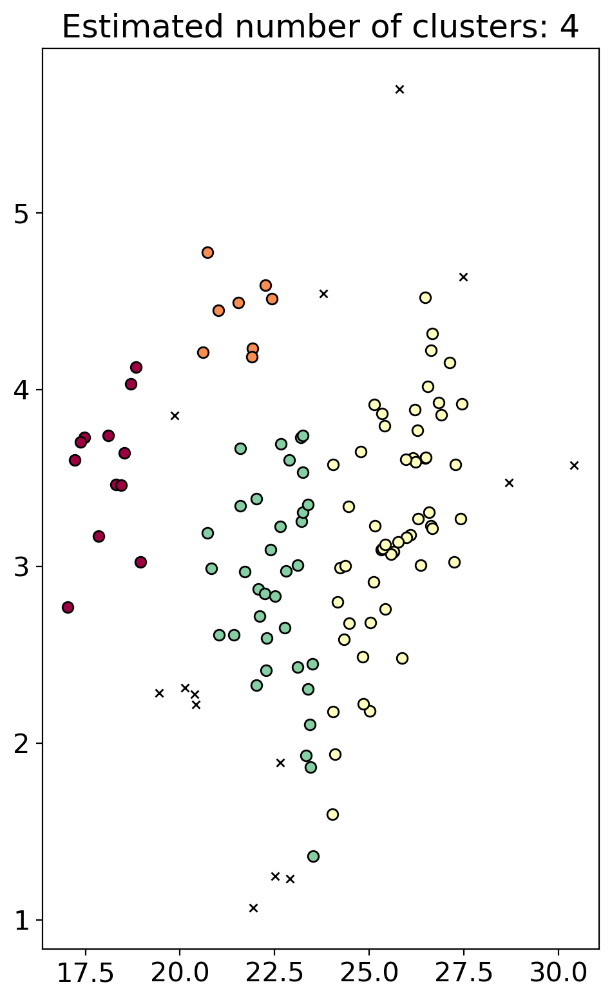

In [221]:
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import DBSCAN, HDBSCAN
from sklearn.datasets import make_blobs


def plot(X, labels, probabilities=None, parameters=None, ground_truth=False, ax=None):
    if ax is None:
        _, ax = plt.subplots(figsize=(5, 8))
    labels = labels if labels is not None else np.ones(X.shape[0])
    probabilities = probabilities if probabilities is not None else np.ones(X.shape[0])
    # Black removed and is used for noise instead.
    unique_labels = set(labels)
    colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
    # The probability of a point belonging to its labeled cluster determines
    # the size of its marker
    proba_map = {idx: probabilities[idx] for idx in range(len(labels))}
    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Black used for noise.
            col = [0, 0, 0, 1]

        class_index = np.where(labels == k)[0]
        for ci in class_index:
            ax.plot(
                X[ci, 0],
                X[ci, 1],
                "x" if k == -1 else "o",
                markerfacecolor=tuple(col),
                markeredgecolor="k",
                markersize=4 if k == -1 else 1 + 5 * proba_map[ci],
            )
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    preamble = "True" if ground_truth else "Estimated"
    title = f"{preamble} number of clusters: {n_clusters_}"
    if parameters is not None:
        parameters_str = ", ".join(f"{k}={v}" for k, v in parameters.items())
        title += f" | {parameters_str}"
    ax.set_title(title)
    plt.tight_layout()

centers = [[1, 1], [-1, -1], [1.5, -1.5]]
X, labels_true = make_blobs(
    n_samples=750, centers=centers, cluster_std=[0.4, 0.1, 0.75], random_state=0
)
X = daily_agg[['SP','uv']]
X['uv'] = X['uv']*0.5
X = X.to_array().data.T
dbs = HDBSCAN( min_cluster_size=8, min_samples=2)
dbs.fit(X)
plot(X, labels=dbs.labels_, ground_truth=False)

# fig, axes = plt.subplots(3, 1, figsize=(10, 12))
# dbs = DBSCAN(eps=0.3)
# for idx, scale in enumerate([1, 0.5, 3]):
#     dbs.fit(X * scale)
#     plot(X * scale, dbs.labels_, parameters={"scale": scale, "eps": 0.3}, ax=axes[idx])

In [346]:
###
# labels = labels_merged4
# labels = labels_merged

In [142]:
def calc_cluster(data, labels, rdim='time'):
    time = np.intersect1d(data.time, labels.time)
    data = data.sel(time=time)
    labels = labels.sel(time=time)
    data = data.assign_coords(label=(rdim, labels.data))#["bmu"] = bmu.astype(np.float)
    clusters = []
    cluster_mean = []
    pct = []
    unique_label = np.unique(labels)
    for _label in unique_label:
        cluster = data.where(data["label"]==_label, drop=True)
        if cluster.coords[rdim].size==0:
            clusters.append(None)
            cluster_mean.append(None)
            pct.append(0.)
        else:
            clusters.append(cluster)
            cluster_mean.append(cluster.mean("time"))
            pct.append(len(cluster.coords["label"]) / len(data.coords["label"]) * 100.)
    return clusters, cluster_mean, pct, unique_label.astype(int)

In [143]:
clusters_merged1, cluster_means_merged1, pcts_merged1 = {}, {}, {}
clusters_merged2, cluster_means_merged2, pcts_merged2 = {}, {}, {}
clusters_adjusted, cluster_means_adjusted, pcts_adjusted = {}, {}, {}
vnames = ['sp', 't2', 'z500', 'z850', 't500', 't850', 'u100', 'v100']
vars = [sp, t2, z500, z850, t500, t850, u100, v100]
for vname, v in zip(vnames, vars):
    clusters_merged1[vname], cluster_means_merged1[vname], pcts_merged1[vname], met_labels_merged1 = calc_cluster(v, labels_met_day_merged1)
    clusters_merged2[vname], cluster_means_merged2[vname], pcts_merged2[vname], met_labels_merged2 = calc_cluster(v, labels_met_day_merged2)
    clusters_adjusted[vname], cluster_means_adjusted[vname], pcts_adjusted[vname], met_labels_adjusted = calc_cluster(v, labels_met_day_adjusted)


In [144]:
print(met_labels_merged1, len(met_labels_merged1))
print(met_labels_merged2, len(met_labels_merged2))
print(met_labels_adjusted, len(met_labels_adjusted))


[ 3  5 10 12 15 16 17 18] 8
[2 3 4 5 6] 5
[ 3  4  6  7  8 10 11 12 13 15 16 17 18] 13


In [145]:
def calc_cluster_lidar(data, labels, rdim='time'):
    time = np.intersect1d(data.time, labels.time)
    data = data.sel(time=time)
    labels = labels.sel(time=time)
    data = data.assign_coords(label=(rdim, labels.data))#["bmu"] = bmu.astype(np.float)
    clusters = []
    cluster_mean = []
    pct = []
    unique_label = np.unique(labels)
    for _label in unique_label:
        cluster = data.where(data["label"]==_label, drop=True)
        if cluster.coords[rdim].size==0:
            clusters.append(None)
            cluster_mean.append(None)
            pct.append(0.)
        else:
            clusters.append(cluster)
            cluster_mean.append(cluster.mean("time"))
            pct.append(len(cluster.coords["label"]) / len(data.coords["label"]) * 100.)
    return clusters, cluster_mean, pct, unique_label.astype(int)
lidar_clusters_merged1, lidar_cluster_means_merged1, lidar_pcts_merged1, lidar_labels_merged1  = calc_cluster_lidar(wind_lidar, labels_lidar_day_merged1)
lidar_clusters_merged2, lidar_cluster_means_merged2, lidar_pcts_merged2, lidar_labels_merged2  = calc_cluster_lidar(wind_lidar, labels_lidar_day_merged2)
lidar_clusters_adjusted, lidar_cluster_means_adjusted, lidar_pcts_adjusted, lidar_labels_adjusted  = calc_cluster_lidar(wind_lidar, labels_lidar_day_adjusted)


In [146]:
print(lidar_labels_merged1, len(lidar_labels_merged1))
print(lidar_labels_merged2, len(lidar_labels_merged2))
print(lidar_labels_adjusted, len(lidar_labels_adjusted))


[ 3  5  9 10 12 14 15 16 17 18] 10
[2 3 4 5 6] 5
[ 3  4  6  7  8  9 10 11 12 13 14 15 16 17 18] 15


In [147]:
map_extent = [-127, -116, 41, 50]
wind_extent = [-124, -119, 43, 48]
WREF_location = [-121.9519, 45.8205]
lat = sp.latitude
lon = sp.longitude


In [148]:
def calc_daynight_mean(da, period):
    if period=='day':
        hours = [15,16,17,18,19,20,21,22,23,0,1,2,3]
    if period=='night':
        hours = [4,5,6,7,8,9,10,11,12,13,14]
    if 'time' in da.coords:  return da.sel(time=da['time.hour'].isin(hours)).mean('time')
    if 'hour' in da.coords:  return da.sel(hour=da['hour'].isin(hours)).mean('hour')

In [149]:
topo = xr.open_dataset(f'../../ERA5_reduced/e5.oper.invariant.128_129_z.ll025sc.1979010100_1979010100.nc')['Z'].squeeze() / 9.8
topo = topo.sel(longitude=slice(map_extent[0]+360, map_extent[1]+360), latitude=slice(map_extent[3], map_extent[2]))

In [103]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    # 2, 4, figsize=(14, 7), 
    3, 5, figsize=(18, 12), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')

for i in np.arange(len(met_labels)):
    v = cluster_means['z500'][i]
    v = v - v.mean(['latitude','longitude'])
    pct = pcts['z500'][i]
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(-10,10,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [5,6,7,8,9] else False,
        draw_ylabel=True if i in [0,5] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])
_=plot_map.add_colorbar(cs, axs[:5], clev[1:-1:4], pad=0.08, shrink=1.5)




NameError: name 'met_labels' is not defined

(0.5, 0.5)


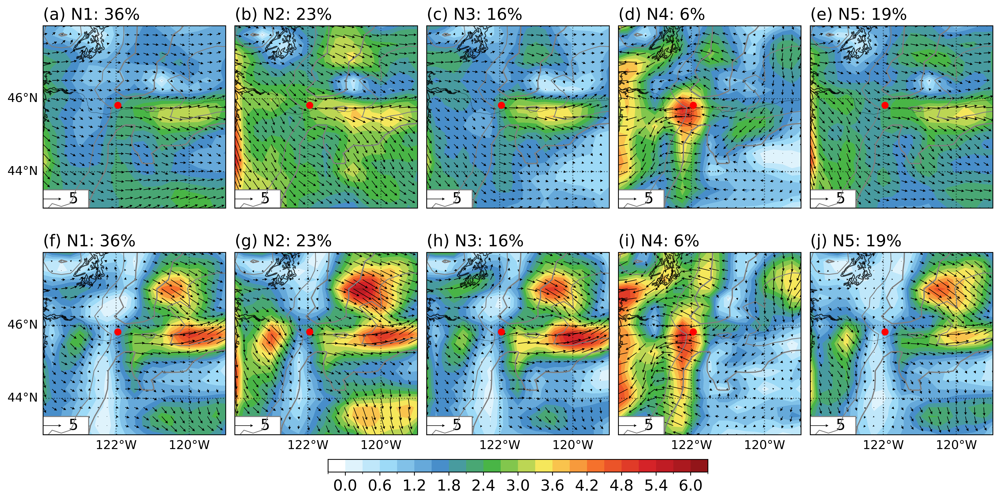

In [359]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 5, figsize=(14, 7.5), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.05, wspace=0.05)

abcd=list('abcdefghijk')
for i in np.arange(len(met_labels)):
    u = clusters['u100'][i]
    u = calc_daynight_mean(u, 'day')
    v = clusters['v100'][i]
    v = calc_daynight_mean(v, 'day')
    pct = pcts['t2'][i]
    var = np.sqrt(u*u + v*v)
    ax = axs[i]
    cs, clev = plot_on_map(
        var,
        fig=fig, ax=ax, extent=wind_extent,
        clev=[-10000]+list(np.linspace(0,6,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        u=u, v=v,
        vector_scale=20,
        # cmap=cm_wind['cmap'],
        cmap='WhiteBlueGreenYellowRed',
        draw_xlabel=True if i in [5,6,7,8,9] else False,
        draw_ylabel=True if i in [0,5] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])
    plot_map.add_geolocation(ax, WREF_location)
    
for i in np.arange(len(met_labels)):
    u = clusters['u100'][i]
    u = calc_daynight_mean(u, 'night')
    v = clusters['v100'][i]
    v = calc_daynight_mean(v, 'night')
    pct = pcts['t2'][i]
    var = np.sqrt(u*u + v*v)
    ax = axs[i+len(met_labels)]
    cs, clev = plot_on_map(
        var,
        fig=fig, ax=ax, extent=wind_extent,
        clev=[-10000]+list(np.linspace(0,6,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        u=u, v=v,
        vector_scale=20,
        # cmap=cm_wind['cmap'],
        cmap='WhiteBlueGreenYellowRed',
        draw_xlabel=True if i+len(met_labels) in [5,6,7,8,9] else False,
        draw_ylabel=True if i+len(met_labels) in [0,5] else False,
        title=f'({abcd[i+len(met_labels)]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])
    plot_map.add_geolocation(ax, WREF_location)


_=plot_map.add_colorbar(cs, axs, clev[1:-1:2], pad=0.05, shrink=0.4)

(0.5, 0.5)


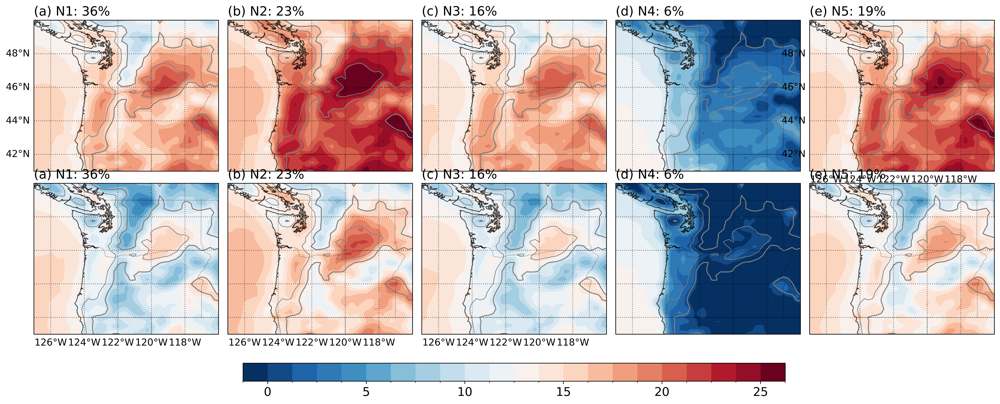

In [360]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 5, figsize=(18, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(len(met_labels)):
    v = clusters['t2'][i]
    v = v.sel(time=v['time.hour'].isin([15,16,17,18,19,20,21,22,23,0,1,2,3])).mean('time')
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(0,25,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

for i in np.arange(len(met_labels)):
    v = clusters['t2'][i]
    v = v.sel(time=v['time.hour'].isin([4,5,6,7,8,9,10,11,12,13,14])).mean('time')
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i+len(met_labels)]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(0,25,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if (i+len(met_labels)) in [4,5,6,7] else False,
        draw_ylabel=True if (i+len(met_labels)) in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

In [361]:
clusters['t2']

[<xarray.DataArray 'VAR_2T' (time: 1578, latitude: 37, longitude: 45)> Size: 11MB
 array([[[ 9.597137  ,  9.784637  , 10.026825  , ..., 16.421356  ,
          17.335419  , 20.03659   ],
         [ 9.411591  ,  9.66745   ,  9.911591  , ..., 17.694794  ,
          18.054169  , 20.585419  ],
         [ 9.884247  ,  9.810028  ,  9.685028  , ..., 18.458466  ,
          18.72409   , 21.296356  ],
         ...,
         [12.419403  , 12.210419  , 12.378387  , ..., 15.632294  ,
          14.933075  , 13.888153  ],
         [12.421356  , 12.190887  , 12.288544  , ..., 17.75534   ,
          15.438934  , 15.276825  ],
         [12.409637  , 12.286591  , 12.298309  , ..., 20.8862    ,
          18.731903  , 17.608856  ]],
 
        [[ 9.88559   ,  9.998871  , 10.07309   , ..., 16.034027  ,
          17.203949  , 19.97934   ],
         [ 9.500824  ,  9.746918  ,  9.821136  , ..., 17.455902  ,
          17.858246  , 20.397308  ],
         [ 9.899261  ,  9.774261  ,  9.688324  , ..., 18.28012   ,
  

(0.5, 0.5)


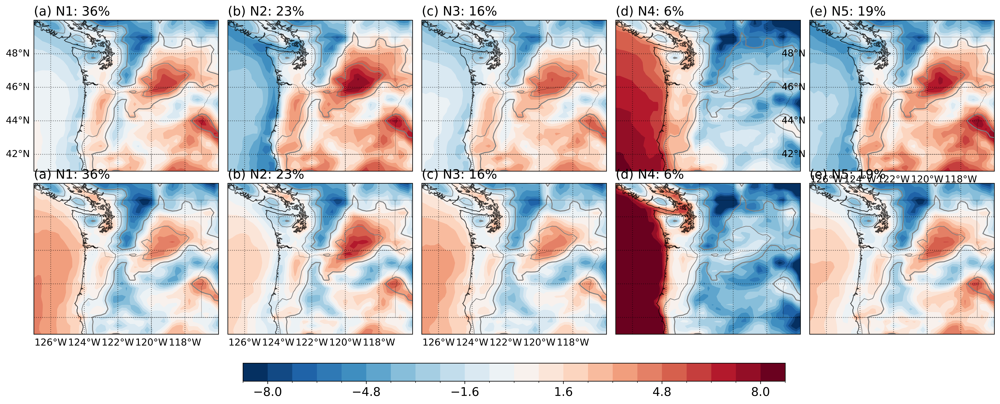

In [362]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 5, figsize=(18, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(len(met_labels)):
    v = clusters['t2'][i]
    v = v.sel(time=v['time.hour'].isin([15,16,17,18,19,20,21,22,23,0,1,2,3])).mean('time')
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v - v.mean(['latitude', 'longitude']),
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(-8,8,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

for i in np.arange(len(met_labels)):
    v = clusters['t2'][i]
    v = v.sel(time=v['time.hour'].isin([4,5,6,7,8,9,10,11,12,13,14])).mean('time')
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i+len(met_labels)]
    cs, clev = plot_on_map(
        v - v.mean(['latitude', 'longitude']),
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(-8,8,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if (i+len(met_labels)) in [4,5,6,7] else False,
        draw_ylabel=True if (i+len(met_labels)) in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

In [363]:
lidar_labels

array([2, 3, 4, 5, 6])

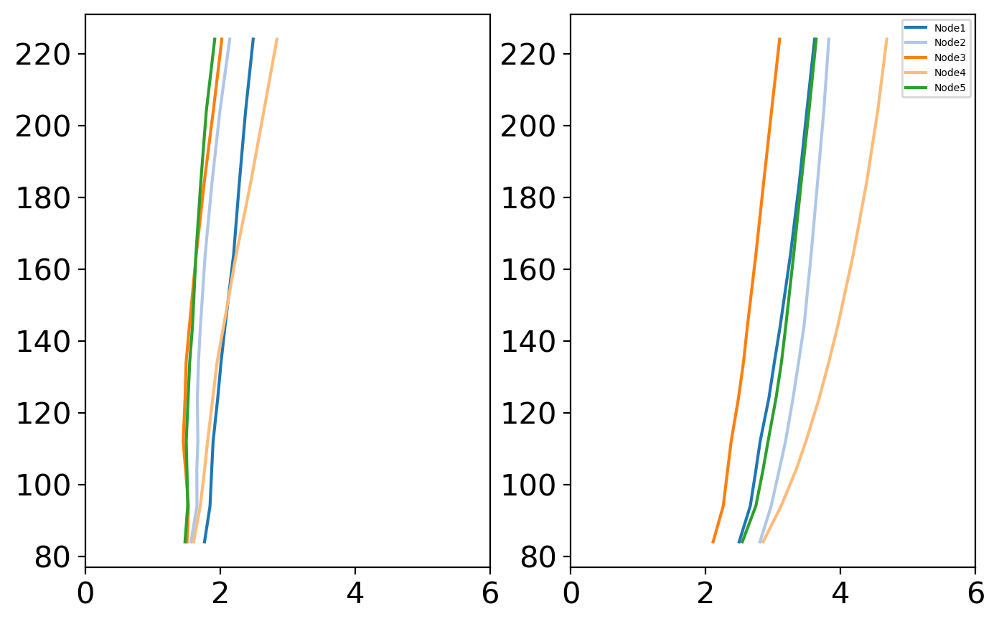

In [364]:
fig, axs = plt.subplots(
    1, 2, figsize=(8, 5), 
    dpi=100,
)
axs = axs.ravel()
base_colors = [
    'tab:red',
    'tab:green',
    'tab:blue',
    'tab:orange',
    'tab:purple',
    'tab:brown',
    'tab:pink',
    'tab:cyan'
] 
# category_colors = create_category_colors(daily_agg['cluster'].data, plt.cm.tab20)
cmap = plt.cm.tab20
for i in np.arange(lidar_labels.size):
    v = lidar_clusters[i]['uv']
    v = v.groupby(v['time.hour']).mean()
    vv = calc_daynight_mean(v, 'night')
    axs[0].plot(vv, vv.level, c=cmap(i), label=f'Node{i+1}')
    vv = calc_daynight_mean(v, 'day')
    axs[1].plot(vv, vv.level, c=cmap(i), label=f'Node{i+1}')
    axs[0].set_xlim(0,6)
    axs[1].set_xlim(0,6)
axs[1].legend(fontsize=5)


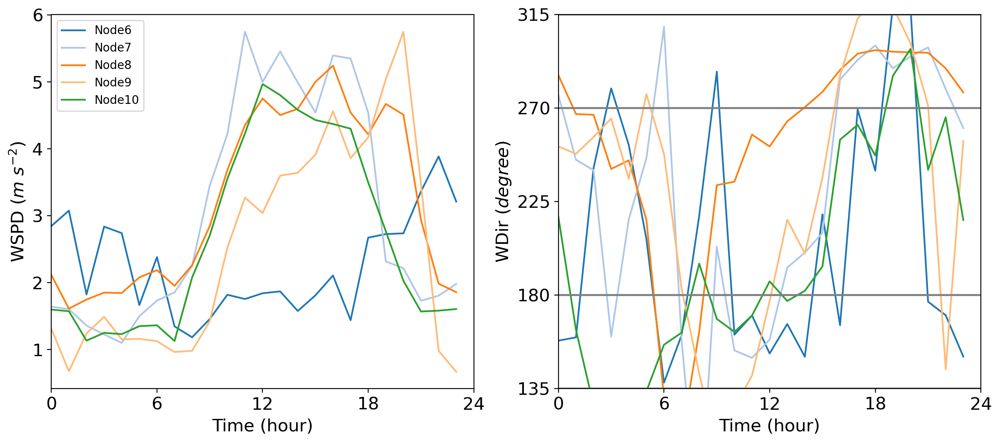

In [158]:
def calculate_wind_direction(u, v):
    # Calculate wind direction in radians
    wind_direction_rad = np.arctan2(-u, -v)
    
    # Convert wind direction to degrees
    wind_direction_deg = np.degrees(wind_direction_rad)
    
    # Ensure the direction is within the range [0, 360)
    wind_direction_deg = (wind_direction_deg + 360) % 360
    return wind_direction_deg

fig, axs = plt.subplots(
    1, 2, figsize=(12, 5), 
    dpi=100,
)
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.2)

cmap = plt.cm.tab20
ax = axs[0]
# for i in np.arange(lidar_labels_adjusted.size):
ii = 0
for i in [5,6,7,8,9]:
    v = lidar_clusters_adjusted[i].sel(level=204)['uv']
    v = v.groupby(v['time.hour']).mean()
    v = v.roll(hour=-8)
    # ax.plot(v.hour, v, label=f'Node{i+1}', color=base_colors[i])
    ax.plot(v.hour, v, label=f'Node{i+1}', color=cmap(ii))
    ax.set_ylabel('WSPD ($m\ s^{-2}$)')
    
    ii += 1
ax.legend(fontsize=10, ncol=1)

ax = axs[1]
# for i in np.arange(lidar_labels_adjusted.size):
ii = 0
for i in [5,6,7,8,9]:
    uu = -lidar_clusters_adjusted[i]['uv'] * np.sin(lidar_clusters_adjusted[i]['wdir'] * np.pi /180.)
    vv = -lidar_clusters_adjusted[i]['uv'] * np.cos(lidar_clusters_adjusted[i]['wdir'] * np.pi /180.)
    uu = uu.sel(level=204)
    vv = vv.sel(level=204)
    uu = uu.groupby(uu['time.hour']).mean()
    vv = vv.groupby(vv['time.hour']).mean()
    wdir = calculate_wind_direction(uu, vv)
    wdir = wdir.roll(hour=-8)

    ax.plot(wdir.hour, wdir, label=f'Node{i+1}', color=cmap(ii))
    ax.axhline(135, c='tab:gray')
    ax.axhline(180, c='tab:gray')

    ax.axhline(270, c='tab:gray')
    ax.axhline(315, c='tab:gray')
    
    ax.set_ylim(135,315)
    ax.set_yticks([135,180,225,270,315])
    ax.set_ylabel('WDir ($degree$)')
    
    ii += 1
    
# ax.legend(fontsize=5, ncol=5)
for ax in axs:
    ax.set_xticks([0, 6, 12, 18,24])
    ax.set_xlim(0, 24)
    ax.set_xlabel('Time (hour)')


In [151]:
np.unique(lidar_labels_adjusted)

array([ 3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18])

In [156]:
from windrose import WindroseAxes, plot_windrose
fig, axs = plt.subplots(
    3, 3, figsize=(14, 12), 
    subplot_kw={"projection": "windrose"},
    dpi=300,
)
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.2, wspace=0.2)
axs = axs.ravel()

for i in [5,6,7,8,9]:
    ax = WindroseAxes.from_ax(ax=axs[i-5], rmax=20)
    ax.bar(lidar_clusters_adjusted[i]['wdir'].sel(level=204), lidar_clusters_adjusted[i]['uv'].sel(level=204), bins=np.arange(0.01, 8, 1), normed=True)
    # ax.set_rmax(20)
    # ax.set_rmin(0)
    ax.set_rlim(0, 20)
    ax.set_rticks([0,5,10,15])
    # ax.set_rlabel_position(120)
axs[0].set_legend(fontsize=8)

In [86]:
def plot_cross_section(data, u=None, v=None, **kwargs):
    mpl.rcParams['font.size'] = 15
    mpl.rcParams['font.family'] = 'Helvetica'  
    
    # create a figure
    if (fig:=kwargs.get('fig')) is None:  
        fig = plt.figure(figsize=(8, 5))
    if (ax:=kwargs.get('ax')) is None:  ax = plt.axes()
    ax.set_axis_on()
    
    # # set map - extent, grid, coastline ...
    # draw_xlabel = kwargs.get('draw_xlabel', True)
    # draw_ylabel = kwargs.get('draw_ylabel', True)

    # plot_map.set_map(
    #     ax,
    #     extent=kwargs.get('extent',[-125+360,-70+360,24,50]),
    #     gridlines_kw=dict(
    #         xticks=[-126,-124,-122,-120,-118,-116,-114,-112],
    #         yticks=[40,42,44,46,48,50],
    #         linestyle=":", alpha=0.5,
    #     ),
    #     gridlabels_kw=dict(
    #         xticks=[-126,-124,-122,-120,-118,-116,-114,-112] if draw_xlabel else [],
    #         yticks=[40,42,44,46,48,50] if draw_ylabel else [],
    #     ),
    #     boundary_kw=dict(
    #         draw_state=True,
    #         coastline_kw=dict(linewidth=0.9, alpha=0.7, color='k'),
    #         draw_borders=True,
    #         border_kw=dict(linewidth=0.9, alpha=0.7, color='k'),
    #     ),
    # )
    
    # lat and lon for contour plot
    if ((lon:=kwargs.get('lon')) is None): lon = data['lon']
    if ((lat:=kwargs.get('lat')) is None): lat = data['lat']
        
    # draw contourf
    cmap = kwargs.get('cmap', "WhiteBlueGreenYellowRed")
    clev = kwargs.get('clev', np.arange(0, 40, 1))

    # cs, clev = plot_map.add_contourf(
    cs, clev = plot_map.add_pcolormesh(
        ax, lon, lat, data,
        cmap=cmap,clev=clev,
        nomap=True,
    )
    # cs = ax.contourf(lon, lat, data, cmap=cm_wind['cmap'], norm=cm_wind['norm'], clev=clev)
    if (u is not None) & (v is not None):
        d = 1
        _lat = lat[::d]#,::d]
        _lon = lon[::d]#,::d]
        # uu, vv = rotate_wind(u[::d,::d], v[::d,::d], _lon)
        uu, vv = u[::d,::d].data, v[::d,::d].data
        vec = plot_map.add_vector(ax,
            _lon.data, _lat.data, uu, vv,
            vector_kwargs=dict(
                scale_units="inches", scale=kwargs.get('vector_scale',15),
            ),
            nomap=True,
        )
        rect = mpl.patches.Rectangle(
            (0., 0),  # (x, y)
            0.25,  # width
            0.1,  # height
            facecolor='white',
            edgecolor='gray',
            transform=ax.transAxes,
        )
        ax.add_patch(rect)
        ax.quiverkey(vec, 0.10, 0.05, 5, "5",labelpos='E', coordinates='axes')
    
    if (overlay:=kwargs.get('overlay')) is not None:
        plot_map.add_hatches(ax, lon, lat, overlay, clev=[0, 0.05], zorder=10)
        
    # draw urban
    # plot_map.add_contour(ax, XLON, XLAT, xlc.where(xlc==5,0), colors='gray', clev=[4.9,5.0,5.1], linewidths=0.8)
        
    # add text - title, ananote
    if (title:=kwargs.get('title')) is not None: 
        default_title_kwargs = dict(loc='left')
        default_title_kwargs.update(kwargs.get('title_kwargs', {}))
        ax.set_title(title, **default_title_kwargs)

    if kwargs.get('draw_colorbar'):
        plot_map.add_colorbar(cs, ax, clev[1:-1])
        
    return cs, clev 

In [ ]:
cross_section['wdir'].min()

NameError: name 'cross_section' is not defined

In [ ]:
np.cos(np.pi/4)

0.7071067811865476

IndexError: list index out of range

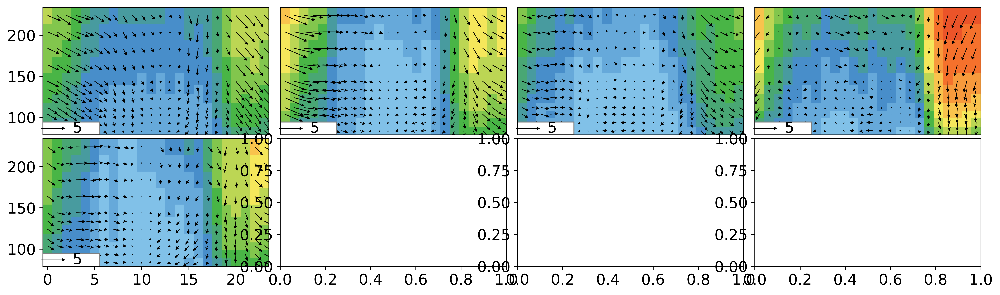

In [84]:
fig, axs = plt.subplots(
    2, 4, figsize=(14, 4), 
    dpi=300,
)
axs = axs.ravel()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.03, wspace=0.05)
for i in np.arange(len(met_labels)):
    cross_section = lidar_clusters[i]
    cross_section = cross_section.groupby(cross_section['time.hour']).mean()
    # print(cross_section)
    plot_cross_section(
        cross_section['uv'].T, 
        lat=cross_section.level, lon=cross_section.hour, 
        fig=fig, ax=axs[i],
        clev=[-10000]+list(np.linspace(0,8,21))+[10000],
        u=-cross_section['uv'].T * np.sin(cross_section['wdir'].T * np.pi /180.), v=cross_section['w'].T *10,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
    )
    if i not in [4,5,6,7]: axs[i].set_xticks([])
    if i not in [0,4]: axs[i].set_yticks([])
